In [1]:
import os
import sys
import re
import pickle
import anndata
import biomart
import scanpy as sc
import numpy as np
import pandas as pd
from scipy import sparse
from scipy.stats import norm
from scipy.stats import rankdata
from sklearn.preprocessing import scale
from sklearn.neighbors import KernelDensity
from sklearn.decomposition import NMF, PCA, non_negative_factorization

In [2]:
sc.settings.verbosity = 3
sc.set_figure_params(dpi=200)

# QC

In [2]:
# function to find valley of a bimodal distribution.
# uses to determine cutoff for 10x data with emptydrop cell calling which usually ends up with a low peak of n_genes_by_counts.
def find_valley_between_bimodal(x, min_peak_size = 0.1, nstep = 100, bandwidth_ratio = 1/30, do_plot = False):
    x_d = np.linspace(x.min(), x.max(), nstep)
    kde = KernelDensity(kernel = 'gaussian', bandwidth = (x.max()-x.min()) * bandwidth_ratio)
    kde.fit(x[:,None])
    logprob = kde.score_samples(x_d[:, None])
    
    d = logprob[1:len(logprob)] - logprob[0:(len(logprob)-1)]
    idx_max = np.where(np.logical_and(d[0:(len(d)-1)]>0, d[1:len(d)]<0))[0]
    idx_max = idx_max[np.exp(logprob)[idx_max] >= np.exp(logprob)[idx_max].max() * min_peak_size]
    if len(idx_max) == 2:
        idx_min = np.where(np.logical_and(d[0:(len(d)-1)]<0, d[1:len(d)]>0))[0]
        idx_min = idx_min[np.logical_and(idx_min < idx_max.max(), idx_min > idx_max.min())]
    else:
        idx_min = -1
    
    max_den = np.array([x_d[idx_max], x_d[idx_max+1]]).mean(0)
    min_den = np.array([x_d[idx_min], x_d[idx_min+1]]).mean(0) if idx_min >= 0 else None
    
    if do_plot:
        plt.fill_between(x_d, np.exp(logprob), alpha=0.5)
        plt.plot(x, np.full_like(x, -0.01), '|k', markeredgewidth=1)
        plt.vlines(x = max_den, color = 'b', ymin=0, ymax=max(np.exp(logprob)))
        if min_den is not None:
            plt.vlines(x = min_den, color = 'r', ymin=0, ymax=max(np.exp(logprob)))
    
    return min_den

# function to identify outliers based on normal distribution
def is_not_outliers(x, min_p = 0.025, max_p = 0.975):
    x_scale = scale(x)
    cut_min = norm.ppf(min_p)
    cut_max = norm.ppf(max_p)
    return np.logical_and(x_scale > cut_min, x_scale < cut_max)

# function to do QC on ngenes and percent.mt
def do_QC(ad, check_valley_10x_v3 = True, col_valley = "n_genes_by_counts", col_ngene = "log1p_n_genes_by_counts", col_mt = "pct_counts_mt", outlier_p = [0.025, 0.975], **kwargs):
    if check_valley_10x_v3 and ad.obs.assay_sc[0] == "10x 3' v3" and ad.shape[0] > 500:
        valley_ngenes = find_valley_between_bimodal(np.array(ad.obs[col_valley]), **kwargs)
        if valley_ngenes is not None:
            ad = ad[ad.obs[col_valley] > valley_ngenes[0],:]
    
    to_keep = is_not_outliers(np.array(ad.obs[col_ngene]), min_p = outlier_p[0], max_p = outlier_p[1])
    if adata.obs[col_mt].max() > 0:
        to_keep = np.logical_and(to_keep, is_not_outliers(np.log1p(np.array(ad.obs[col_mt])), min_p = 0, max_p = outlier_p[1]))
    
    return ad[to_keep,:]

In [3]:
adata = sc.read("/storage/data/organoid_atlas_adatas/230510_01_organoids_raw.h5ad")
adata

AnnData object with n_obs × n_vars = 1931957 × 36842
    obs: 'assay_sc', 'assay_differentiation', 'assay_type_differentiation', 'bio_sample', 'cell_line', 'cell_type', 'development_stage', 'disease', 'ethnicity', 'gm', 'id', 'individual', 'organ', 'organism', 'sex', 'state_exact', 'sample_source', 'source_doi', 'suspension_type_original', 'tech_sample', 'treatment', 'assay_sc_original', 'cell_line_original', 'cell_type_original', 'development_stage_original', 'disease_original', 'ethnicity_original', 'organ_original', 'organism_original', 'sex_original', 'suspension_type', 'obs_names_original', 'organoid_age_days', 'publication', 'doi', 'batch'
    var: 'ensembl', 'gene_symbol'
    uns: 'annotated', 'assay_differentiation', 'assay_sc', 'assay_type_differentiation', 'author', 'cell_line', 'cell_type', 'default_embedding', 'development_stage', 'disease', 'doi_journal', 'doi_preprint', 'download_url_data', 'download_url_meta', 'ethnicity', 'gm', 'id', 'load_raw', 'mapped_features', 'orga

In [4]:
# calculate QC metrics
adata.var['mt'] = adata.var_names.str.startswith('MT-') 
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt',], percent_top=None, log1p=True, inplace=True)

In [5]:
# baseline QC: remove any cells with 200 genes or less expressed
adata = adata[adata.obs["n_genes_by_counts"]>200].copy()
adata.shape

(1930927, 36842)

In [6]:
# QC per data set, or per sample if it is available
adata_ds = [adata[adata.obs["publication"] == sample] for sample in adata.obs["publication"].cat.categories]

In [7]:
adata_ds_QC = list()
for ad in adata_ds:
    print("doing QC for " + ad.obs["publication"][0])
    if np.isin(ad.obs["publication"][0], ['Fleck, 2022']):
        adata_ds_QC.append(ad)
        continue
    
    ad_samples = [ad[ad.obs["batch"] == x] for x in ad.obs["batch"].unique()]
    for i in range(len(ad_samples)):
        ad_samples[i] = do_QC(ad_samples[i], min_peak_size = 1/3)
    ad = anndata.concat(ad_samples)
    adata_ds_QC.append(ad)

adata_QC = anndata.concat(adata_ds_QC)
adata_QC.var = adata.var.copy()

display(pd.DataFrame({'original_ncells' : adata.obs["publication"].value_counts(),
              'QCed_ncells' : adata_QC.obs["publication"].value_counts(),
              'original_ngenes' : adata.obs.groupby('publication')['n_genes_by_counts'].median(),
              'QCed_ngenes' : adata_QC.obs.groupby('publication')['n_genes_by_counts'].median()}))
adata_QC.shape

doing QC for Andersen, 2020


/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:259: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data

doing QC for Bhaduri, 2020


/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:259: UserWarning: Numerical issues were encountered when sca

doing QC for Birey, 2017
doing QC for Bowles, 2021


/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:259: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data

doing QC for Fiorenzano, 2021


/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when cen

doing QC for Fleck, 2022
doing QC for He, 2022


/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:259: UserWarning: Numerical issues were encountered when sca

doing QC for Huang, 2021


/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:259: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:259: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not 

doing QC for Kanton, 2019


/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when cen

doing QC for Kelava, 2022
doing QC for Khan, 2020


/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:259: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data

doing QC for Marton, 2019
doing QC for Miura, 2020


/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:259: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data

doing QC for Paulsen, 2022


/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:259: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:259: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not 

doing QC for Pellegrini, 2020


/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:259: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data

doing QC for Qian, 2020
doing QC for Quadrato, 2023


/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(


doing QC for Samarasinghe, 2021


/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:259: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


doing QC for Sawada, 2020
doing QC for Sloan, 2017


/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:259: UserWarning: Numerical issues were encountered when sca

doing QC for Treutlein, 2023


/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:259: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data

doing QC for Trujillo, 2019


/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:259: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data

doing QC for Uzquiano, 2022


/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:259: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data

doing QC for Velasco, 2019


/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:259: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data

doing QC for Vertesy, 2022


/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:259: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data

doing QC for Xiang, 2019


/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(


doing QC for Yoon, 2019


/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:259: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data

,original_ncells,QCed_ncells,original_ngenes,QCed_ngenes
"Andersen, 2020",17625,16703,1577.0,1636.0
"Bhaduri, 2020",238545,223453,1073.0,1048.0
"Birey, 2017",11838,11306,1345.0,1347.0
"Bowles, 2021",217455,202090,2832.0,2953.0
"Fiorenzano, 2021",123158,110026,2538.0,2634.0
"Fleck, 2022",32278,32278,4234.0,4234.0
"He, 2022",87051,82121,2353.0,2381.0
"Huang, 2021",28619,26693,455.0,446.0
"Kanton, 2019",82976,78491,2373.5,2378.0
"Kelava, 2022",2935,2758,1040.0,986.5


(1770578, 36842)

In [8]:
adata_QC.shape

(1770578, 36842)

In [9]:
adata = adata_QC
del adata_QC

In [10]:
# rerun QC metrics
adata.var['mt'] = adata.var_names.str.startswith('MT-') 
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt',], percent_top=None, log1p=True, inplace=True)

In [11]:
adata

AnnData object with n_obs × n_vars = 1770578 × 36842
    obs: 'assay_sc', 'assay_differentiation', 'assay_type_differentiation', 'bio_sample', 'cell_line', 'cell_type', 'development_stage', 'disease', 'ethnicity', 'gm', 'id', 'individual', 'organ', 'organism', 'sex', 'state_exact', 'sample_source', 'source_doi', 'suspension_type_original', 'tech_sample', 'treatment', 'assay_sc_original', 'cell_line_original', 'cell_type_original', 'development_stage_original', 'disease_original', 'ethnicity_original', 'organ_original', 'organism_original', 'sex_original', 'suspension_type', 'obs_names_original', 'organoid_age_days', 'publication', 'doi', 'batch', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt'
    var: 'ensembl', 'gene_symbol', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'

# Gene-length-normalise smarteq2 data and preprocess all data

In [12]:
# retrieve gene length as the primary transcript length
# there are genes without record in this provided gene lengths table. try to retrieve gene length with biomart, in priority of newer to older versions
def get_ensembl_info(url = "http://www.ensembl.org/biomart"):
    print("processing:", url)
    server = biomart.BiomartServer(url)
    mart = server.datasets['hsapiens_gene_ensembl']
    attributes = list(np.intersect1d(['ensembl_gene_id', 'ensembl_gene_id_version', 'hgnc_symbol', 'gene_biotype', 'ensembl_transcript_id', 'transcript_is_canonical', 'transcript_length'],
                                     list(mart.attributes.keys())))
    response = mart.search({'attributes': attributes})
    data = response.raw.data.decode('ascii')
    
    ensembl_meta = list()
    for line in data.splitlines():
        line = line.split('\t')
        ensembl_meta.append(tuple(line))
    ensembl_meta = pd.DataFrame(ensembl_meta, columns=attributes)
    
    return ensembl_meta

# compute gene lengths
def get_gene_lengths(meta, only_canonical = True, summary_method = "median"):
    meta_cols = np.intersect1d(['ensembl_gene_id','ensembl_gene_id_version','gene_biotype','hgnc_symbol'], meta.columns)
    meta_per_gene = meta.groupby("ensembl_gene_id")
    meta_per_gene_list = list()
    for gene in meta['ensembl_gene_id'].unique():
        meta_this = meta_per_gene.get_group(gene)
        lens = meta_this['transcript_length'].astype('int32')
        if (meta_this.columns == "transcript_is_canconical").sum() > 0 and only_canonical and (meta_this['transcript_is_canonical'] == '1').sum() > 0:
            lens = meta_this.loc[meta_this['transcript_is_canonical'] == '1','transcript_length'].astype('int32')
        if summary_method == 'median':
            summ_len = lens.median()
        elif summary_method == "mean":
            summ_len = lens.mean()
        elif summary_method == "max":
            summ_len = lens.max()
        else:
            print("Error: summary_method should have the value as one of 'median', 'mean' and 'max'")
            return
        meta_gene = meta_this.loc[:,meta_cols].head(1)
        meta_gene['gene_length'] = [summ_len]
        meta_per_gene_list.append(meta_gene)
    return pd.concat(meta_per_gene_list)

In [14]:
servers = [ "http://" + x + "/biomart" for x in ['www.ensembl.org',# v.109 (GC43)
                                                 'oct2022.archive.ensembl.org',# v.108 (GC42)
                                                 'jul2022.archive.ensembl.org',# v.107 (GC41)
                                                 'apr2022.archive.ensembl.org',# v.106 (GC40)
                                                 'dec2021.archive.ensembl.org',# v.105 (GC39)
                                                 'may2021.archive.ensembl.org',# v.104 (GC38)
                                                 'feb2021.archive.ensembl.org',# v.103 (GC37)
                                                 'nov2020.archive.ensembl.org',# v.102 (GC36)
                                                 'aug2020.archive.ensembl.org',# v.101 (GC35)
                                                 'apr2020.archive.ensembl.org',# v.100 (GC34)
                                                 'jan2020.archive.ensembl.org',# v.99 (GC33)
                                                 'sep2019.archive.ensembl.org',# v.98 (GC32)
                                                 'jul2019.archive.ensembl.org',# v.97 (GC31)
                                                 'apr2019.archive.ensembl.org',# v.96 (GC30)
                                                 'oct2018.archive.ensembl.org',# v.94 (GC29)
                                                 'apr2018.archive.ensembl.org']] # v.92 (GC28)
meta_ensembl = [ get_ensembl_info(x) for x in servers ]

gene_lengths_ensembl = [ get_gene_lengths(x, summary_method = 'max') for x in meta_ensembl ]
idx_ensembl_for_gene_length = np.apply_along_axis(lambda x: np.where(x)[0].min(), 0, np.array([ adata.var.ensembl.isin(x['ensembl_gene_id']) for x in gene_lengths_ensembl ]))
gene_lengths_biomart = [ gene_lengths_ensembl[idx_ensembl_for_gene_length[i]]['gene_length'].iloc[np.where(gene_lengths_ensembl[idx_ensembl_for_gene_length[i]]['ensembl_gene_id'] == adata.var.ensembl[i])[0][0]] for i in range(len(idx_ensembl_for_gene_length))]

processing: http://www.ensembl.org/biomart
processing: http://oct2022.archive.ensembl.org/biomart
processing: http://jul2022.archive.ensembl.org/biomart
processing: http://apr2022.archive.ensembl.org/biomart
processing: http://dec2021.archive.ensembl.org/biomart
processing: http://may2021.archive.ensembl.org/biomart
processing: http://feb2021.archive.ensembl.org/biomart
processing: http://nov2020.archive.ensembl.org/biomart
processing: http://aug2020.archive.ensembl.org/biomart
processing: http://apr2020.archive.ensembl.org/biomart
processing: http://jan2020.archive.ensembl.org/biomart
processing: http://sep2019.archive.ensembl.org/biomart
processing: http://jul2019.archive.ensembl.org/biomart
processing: http://apr2019.archive.ensembl.org/biomart
processing: http://oct2018.archive.ensembl.org/biomart
processing: http://apr2018.archive.ensembl.org/biomart


In [16]:
adata.var['gene_length'] = gene_lengths_biomart
adata.write_h5ad("/storage/data/organoid_atlas_adatas/230510_02_organoids_qcd.h5ad", compression="gzip")

In [4]:
adata.layers['counts'] = adata.X.copy()

In [5]:
# normalize by gene length for the Smart-seq2 data
adata_wtumi = adata[adata.obs["assay_sc"] != "Smart-seq2"]
adata_ss2 = adata[adata.obs["assay_sc"] == "Smart-seq2"]
adata_ss2.X = adata_ss2.X / adata_ss2.var["gene_length"].values * np.median(adata_ss2.var["gene_length"].values)
adata_ss2.X = np.rint(adata_ss2.X)
var = adata.var.copy()
adata = anndata.concat((adata_wtumi, adata_ss2))
adata.var = var
del adata_ss2, adata_wtumi, var

In [6]:
adata.layers["counts_lengthnorm"] = adata.X.copy()

In [6]:
# preprocessing unintegrated data
sc.pp.normalize_total(adata, target_sum=1e6)
sc.pp.log1p(adata)
sc.pp.highly_variable_genes(adata, layer="counts_lengthnorm", n_top_genes=3000, flavor='seurat_v3', batch_key="bio_sample")
adata.obsm["X_pca_unintegrated"] = sc.pp.pca(adata, n_comps=50, copy=True).obsm["X_pca"]
sc.pp.neighbors(adata, use_rep="X_pca_unintegrated", n_neighbors=30, metric="cosine", key_added="knn_pca_unintegrated")
adata.obsm["X_umap_pca_unintegrated"] = sc.tl.umap(adata, neighbors_key="knn_pca_unintegrated", copy=True).obsm["X_umap"]
sc.tl.leiden(adata, neighbors_key="knn_pca_unintegrated", resolution=1, key_added='leiden_pca_unintegrated_1')
sc.tl.leiden(adata, neighbors_key="knn_pca_unintegrated", resolution=80, key_added='leiden_pca_unintegrated_80')

adata.write_h5ad("/storage/data/organoid_atlas_adatas/230510_03_organoids_processed.h5ad", compression="gzip")

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes


/home/ubuntu/venv/organoids/lib/python3.10/site-packages/scanpy/preprocessing/_highly_variable_genes.py:62: UserWarning: `flavor='seurat_v3'` expects raw count data, but non-integers were found.
  warnings.warn(


--> added
    'highly_variable', boolean vector (adata.var)
    'highly_variable_rank', float vector (adata.var)
    'means', float vector (adata.var)
    'variances', float vector (adata.var)
    'variances_norm', float vector (adata.var)
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:04:51)
computing neighbors


/home/ubuntu/venv/organoids/lib/python3.10/site-packages/umap/distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/umap/distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/home/ubuntu/venv/organoids/lib/python3.10/site-packages/umap/distances.py:1086: Num

    finished: added to `.uns['knn_pca_unintegrated']`
    `.obsp['knn_pca_unintegrated_distances']`, distances for each pair of neighbors
    `.obsp['knn_pca_unintegrated_connectivities']`, weighted adjacency matrix (0:07:09)
computing UMAP


IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:35:45)
running Leiden clustering


IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out


    finished: found 60 clusters and added
    'leiden_pca_unintegrated_1', the cluster labels (adata.obs, categorical) (1:09:25)
running Leiden clustering
    finished: found 1109 clusters and added
    'leiden_pca_unintegrated_80', the cluster labels (adata.obs, categorical) (4:42:52)


# RSS

In [7]:
# Calculate correlation between columns in matrix X and those in matrix Y, with X and Y being dense or sparse
def corSparse(X, Y = None):
    Y = X if Y is None else Y
    n = X.shape[0]
    muX = np.ravel(X.mean(0))
    muY = np.ravel(Y.mean(0))
    covmat = ( X.T.dot(Y) - (n * muX[:,np.newaxis].dot(muY[:,np.newaxis].T)) ) / (n-1)
    sdvecX = np.ravel(np.sqrt(((X.power(2)).sum(0) - n*(muX**2)) / (n-1)) if sparse.issparse(X) else np.sqrt(((X**2).sum(0) - n*(muX**2)) / (n-1)))
    sdvecY = np.ravel(np.sqrt(((Y.power(2)).sum(0) - n*(muY**2)) / (n-1)) if sparse.issparse(Y) else np.sqrt(((Y**2).sum(0) - n*(muY**2)) / (n-1)))
    cormat = covmat / sdvecX[:,np.newaxis].dot(sdvecY[:,np.newaxis].T)
    return cormat

# Similar to rankMatrix, but only ranking non-zero values with zero values remaining zero
def rankMatrix_nonzero(X):
    if sparse.issparse(X):
        idx_row, idx_col, dat = sparse.find(X)
        df = pd.DataFrame({'i' : idx_row, 'j' : idx_col, 'x' : dat})
        df['r'] = np.concatenate([ rankdata(x) for x in np.split(df.x, np.unique(df.j, return_index=True)[1][1:]) ])
        ranked = sparse.csr_matrix((df['r'], (df['i'], df['j'])), shape = X.shape)
    else:
        ranked = rankdata(X, method = "average", axis=0)
    return ranked

In [ ]:
# run RSS to Braun et al. 
ref = pd.read_csv("/storage/data/organoid_atlas_adatas/HumanFetalBrainPool_cluster_expr_highvar.tsv", sep="\t")
ref = ref.loc[np.isin(ref.index, adata.var_names),:]

ref_ranked = rankMatrix_nonzero(ref)
ranked_X = rankMatrix_nonzero(adata[:,ref.index].X.T)

cor2ref_spearman = corSparse(ranked_X, ref_ranked)
cor2ref_spearman_scaled = scale(cor2ref_spearman, axis = 1)
cor2ref_spearman_scaled[np.isnan(cor2ref_spearman_scaled)] = 0

pca_rss = PCA(n_components=20).fit_transform(cor2ref_spearman_scaled)

# run UMAP and do clustering based on RSS
adata.obsm['X_rss'] = cor2ref_spearman_scaled
adata.obsm['X_pca_rss'] = pca_rss
sc.pp.neighbors(adata, use_rep = "X_pca_rss", key_added="knn_pca_rss", n_neighbors=30, metric="cosine")
adata.obsm['X_umap_pca_rss'] = sc.tl.umap(adata, neighbors_key="knn_pca_rss", min_dist = 0.3, copy=True).obsm['X_umap']
sc.tl.leiden(adata, neighbors_key="knn_pca_rss", resolution = 1, key_added = 'leiden_pca_rss_1')
sc.tl.leiden(adata, neighbors_key="knn_pca_rss", resolution = 80, key_added = 'leiden_pca_rss_80')

adata.write_h5ad("/storage/data/organoid_atlas_adatas/230510_04_organoids_rss.h5ad", compression="gzip")

# SnapSeed pre integration

In [59]:
def run_snapseed(adata, name):
    import snapseed as snap
    from snapseed.utils import read_yaml

    marker_hierarchy = read_yaml("/storage/data/organoid_atlas_adatas/Data_S1_snapseed_markers.yaml")
    savepath = "/storage/data/organoid_atlas_adatas/230510_data/"

    adata.obs["snap_clusters"] = adata.obs[f"leiden_{name}_80"].astype(str)
    snap_annot = snap.annotate_hierarchy(
        adata,
        marker_hierarchy,
        "snap_clusters",
        layer=None,
        method="auroc",
        min_expr=0,
        expr_weight=1,
        auc_weight=1,
        marker_summary_fun="max",
    )
    del adata.obs["snap_clusters"]
    snap_annot["assignments"].columns = [f"snapseed_{name}_{i}" for i in snap_annot["assignments"].columns]    
    snap_annot["assignments"].to_csv(f"{savepath}snapsed_annot_{name}_{level}.tsv", sep="\t")
    for level, df in snap_annot["metrics"].items():
        df.to_csv(f"{savepath}snapsed_metrics_{name}_{level}.tsv", sep="\t")
    with open(f"{savepath}snapseed_{name}.pickle", "wb") as f:
        pickle.dump(snap_annot, f)
    return snap_annot

In [50]:
name = "pca_unintegrated"
snap_annot = run_snapseed(adata, name)

adata.obs = adata.obs.join(snap_annot["assignments"], on=f"leiden_{name}_80")
adata.obs[f"snapseed_{name}_level_12"] = adata.obs[f"snapseed_{name}_level_2"].fillna(value=adata.obs[f"snapseed_{name}_level_1"])
adata.obs[f"snapseed_{name}_level_123"] = adata.obs[f"snapseed_{name}_level_3"].fillna(value=adata.obs[f"snapseed_{name}_level_12"])
adata.obs[f"snapseed_{name}_level_1234"] = adata.obs[f"snapseed_{name}_level_4"].fillna(value=adata.obs[f"snapseed_{name}_level_123"])
adata.obs[f"snapseed_{name}_level_12345"] = adata.obs[f"snapseed_{name}_level_5"].fillna(value=adata.obs[f"snapseed_{name}_level_1234"])
adata.strings_to_categoricals()

In [52]:
name = "pca_rss"
snap_annot = run_snapseed(adata, name)

adata.obs = adata.obs.join(snap_annot["assignments"], on=f"leiden_{name}_80")
adata.obs[f"snapseed_{name}_level_12"] = adata.obs[f"snapseed_{name}_level_2"].fillna(value=adata.obs[f"snapseed_{name}_level_1"])
adata.obs[f"snapseed_{name}_level_123"] = adata.obs[f"snapseed_{name}_level_3"].fillna(value=adata.obs[f"snapseed_{name}_level_12"])
adata.obs[f"snapseed_{name}_level_1234"] = adata.obs[f"snapseed_{name}_level_4"].fillna(value=adata.obs[f"snapseed_{name}_level_123"])
adata.obs[f"snapseed_{name}_level_12345"] = adata.obs[f"snapseed_{name}_level_5"].fillna(value=adata.obs[f"snapseed_{name}_level_1234"])
adata.strings_to_categoricals()

In [58]:
adata.write_h5ad("/storage/data/organoid_atlas_adatas/230510_06_organoids_preannotated.h5ad", compression="gzip")

# scPoli

In [ ]:
adata.layers["lognorm"] = adata.X.copy()
adata.X = adata.layers["counts_lengthnorm"].A.copy()

scpoli_model = scPoli(
    adata=adata,
    unknown_ct_names=["unknown"],
    condition_key="batch",
    cell_type_keys=["snapseed_pca_rss_level_1", "snapseed_pca_rss_level_12", "snapseed_pca_rss_level_123"],
    embedding_dim=5,
    hidden_layer_sizes=[1024]
)

early_stopping_kwargs = {
    "early_stopping_metric": "val_prototype_loss",
    "mode": "min",
    "threshold": 0,
    "patience": 20,
    "reduce_lr": True,
    "lr_patience": 13,
    "lr_factor": 0.1,
}

scpoli_model.train(
    unlabeled_prototype_training=False,
    n_epochs=7,
    pretraining_epochs=5,
    early_stopping_kwargs=early_stopping_kwargs,
    eta=10,
    alpha_epoch_anneal=100
)

scpoli_model.save("/storage/data/organoid_atlas_adatas/230510_data/scpoli_hierarchical123/")
scpoli_model.get_conditional_embeddings().write_h5ad(
    "/storage/data/organoid_atlas_adatas/230510_data/scpoli_hierarchical123/organoids_scpoli_herarchical123_sample_embedding.h5ad")

adata.obsm["X_scpoli"] = scpoli_model.get_latent(
    adata,
    mean=True
)

adata.X = adata.layers["lognorm"].copy()

In [ ]:
sc.pp.neighbors(adata, use_rep = "X_scpoli", key_added="knn_scpoli")
adata.obsm['X_umap_scpoli'] = sc.tl.umap(adata, neighbors_key="knn_scpoli", copy=True).obsm['X_umap']
sc.tl.leiden(adata, neighbors_key="knn_scpoli", resolution = 1, key_added = 'leiden_scpoli_1')
sc.tl.leiden(adata, neighbors_key="knn_scpoli", resolution = 80, key_added = 'leiden_scpoli_80')

In [ ]:
adata.write_h5ad("/storage/data/organoid_atlas_adatas/230510_07_organoids_integrated.h5ad", compression="gzip")

# SnapSeed post integration

In [112]:
name = "scpoli"
snap_annot = run_snapseed(adata, name)

adata.obs = adata.obs.join(snap_annot["assignments"], on=f"leiden_{name}_80")
adata.obs[f"snapseed_{name}_level_12"] = adata.obs[f"snapseed_{name}_level_2"].fillna(value=adata.obs[f"snapseed_{name}_level_1"])
adata.obs[f"snapseed_{name}_level_123"] = adata.obs[f"snapseed_{name}_level_3"].fillna(value=adata.obs[f"snapseed_{name}_level_12"])
adata.obs[f"snapseed_{name}_level_1234"] = adata.obs[f"snapseed_{name}_level_4"].fillna(value=adata.obs[f"snapseed_{name}_level_123"])
adata.obs[f"snapseed_{name}_level_12345"] = adata.obs[f"snapseed_{name}_level_5"].fillna(value=adata.obs[f"snapseed_{name}_level_1234"])
adata.strings_to_categoricals()

In [113]:
adata.write_h5ad("/storage/data/organoid_atlas_adatas/230510_08_organoids_labelled_.h5ad", compression="gzip")

# Plots

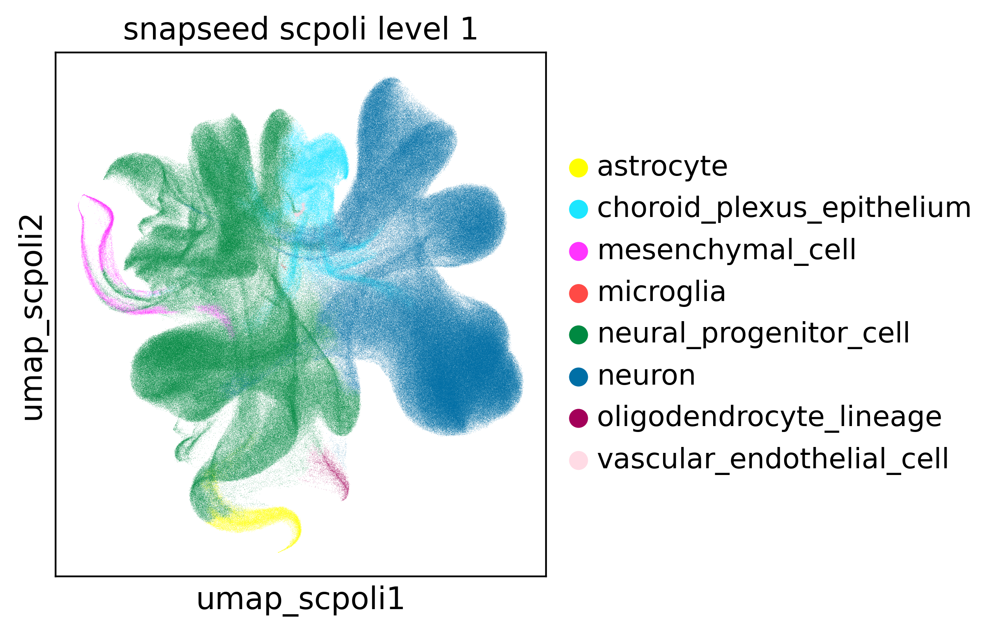

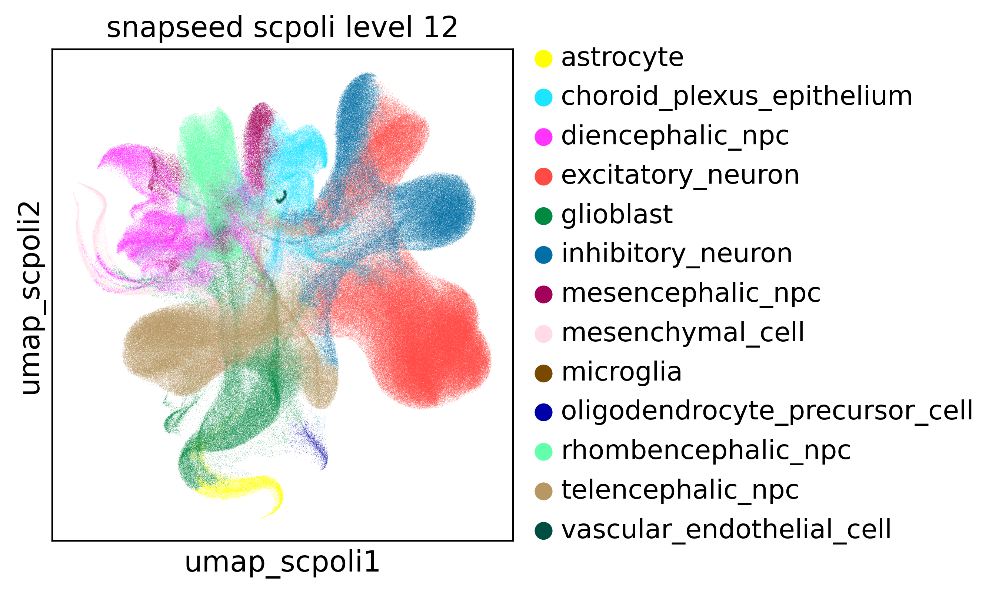

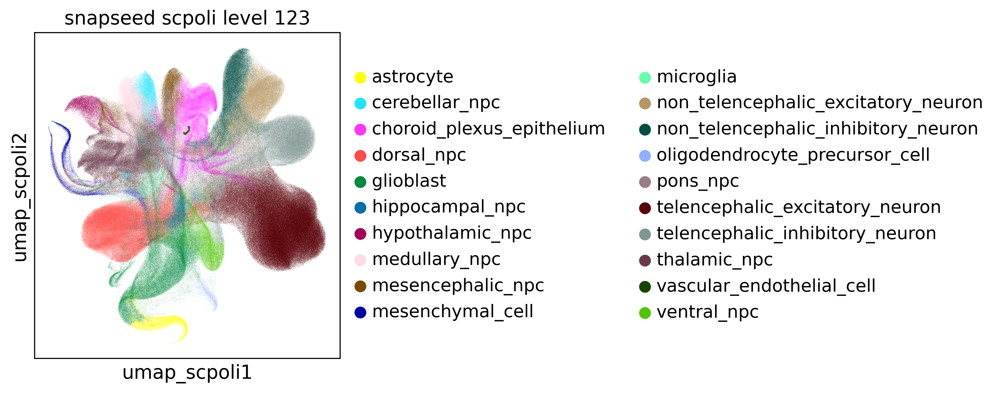

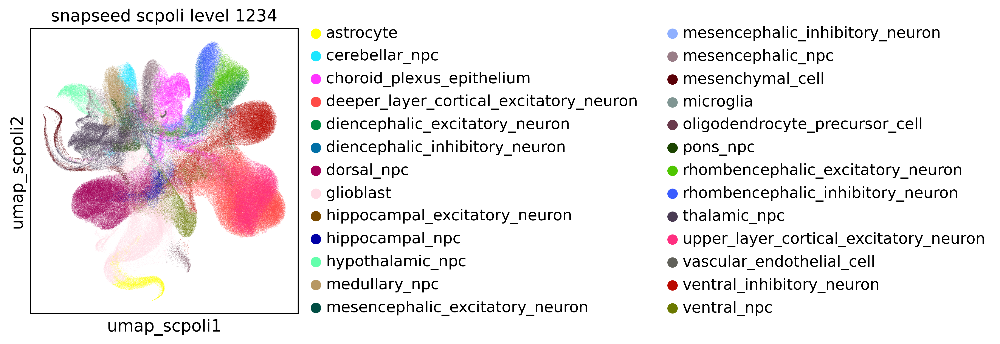

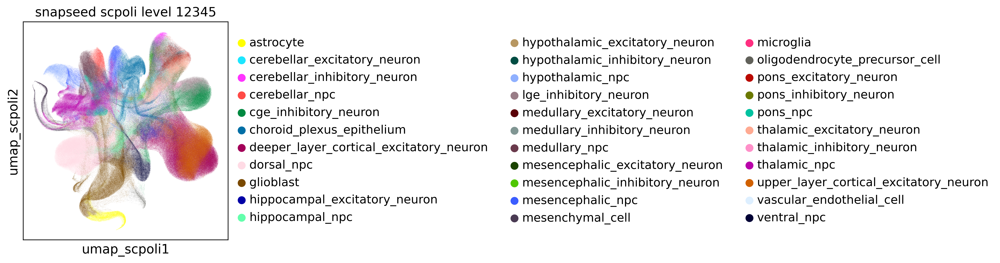

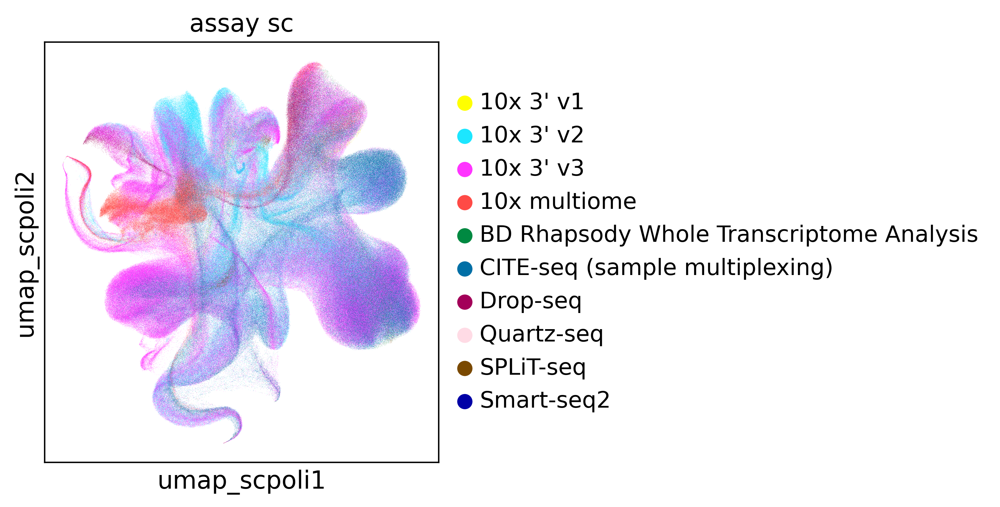

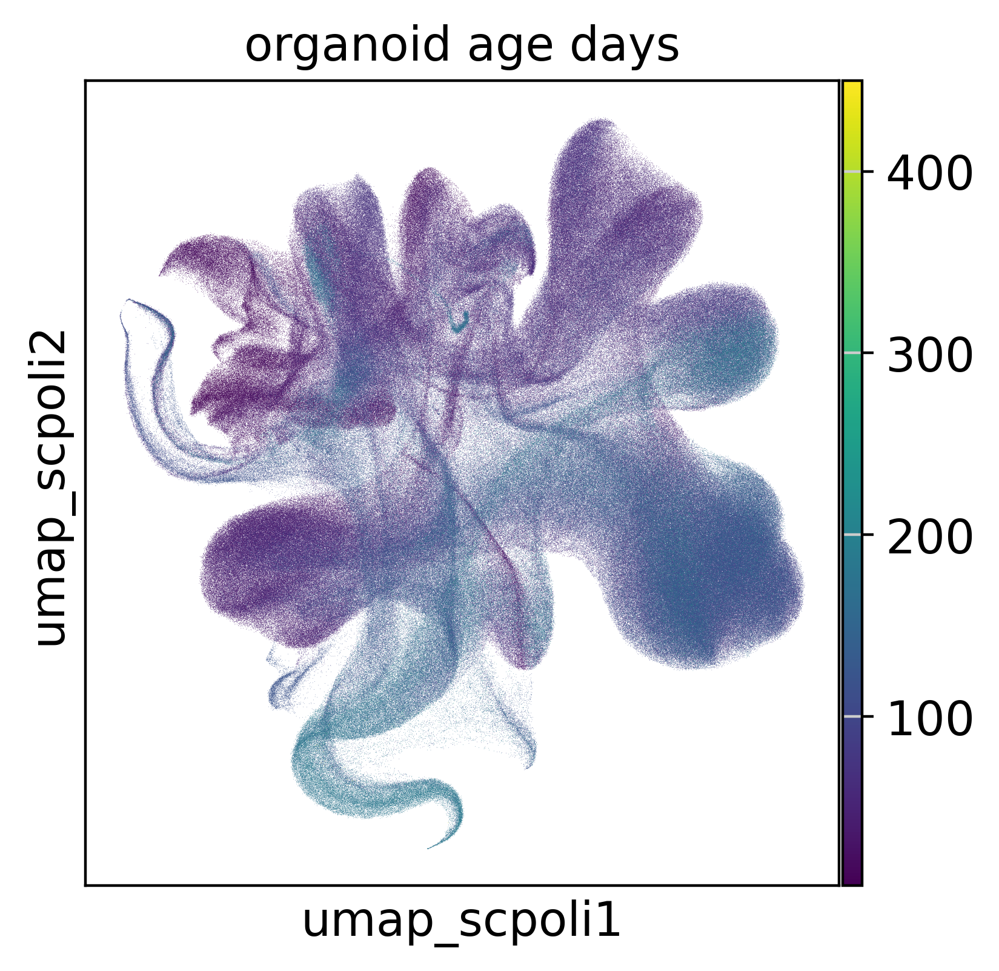

In [123]:
for k in ["snapseed_scpoli_level_1", "snapseed_scpoli_level_12", "snapseed_scpoli_level_123", "snapseed_scpoli_level_1234", "snapseed_scpoli_level_12345", "assay_sc", "organoid_age_days"]:
    sc.pl.scatter(adata, basis="umap_scpoli", color=k, palette=sc.pl.palettes.default_102)

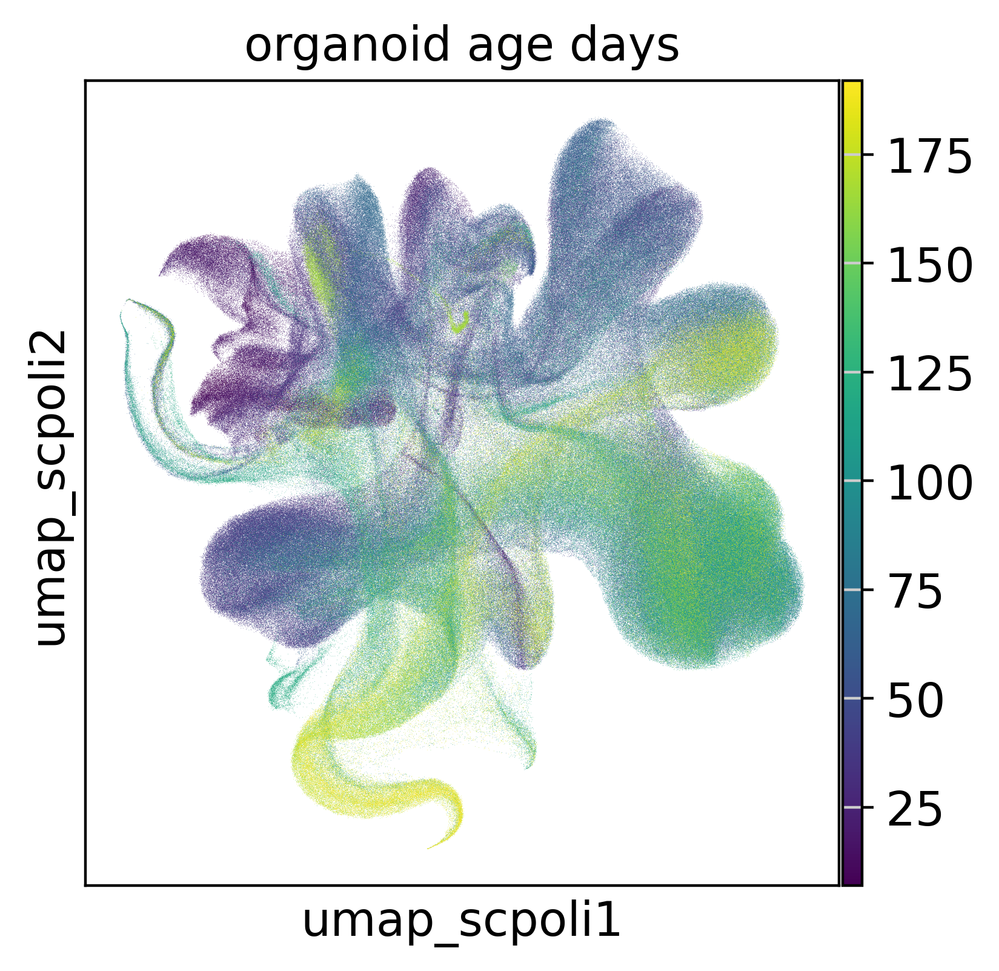

In [127]:
sc.pl.scatter(adata[adata.obs["organoid_age_days"]<=200], basis="umap_scpoli", color=["organoid_age_days"])

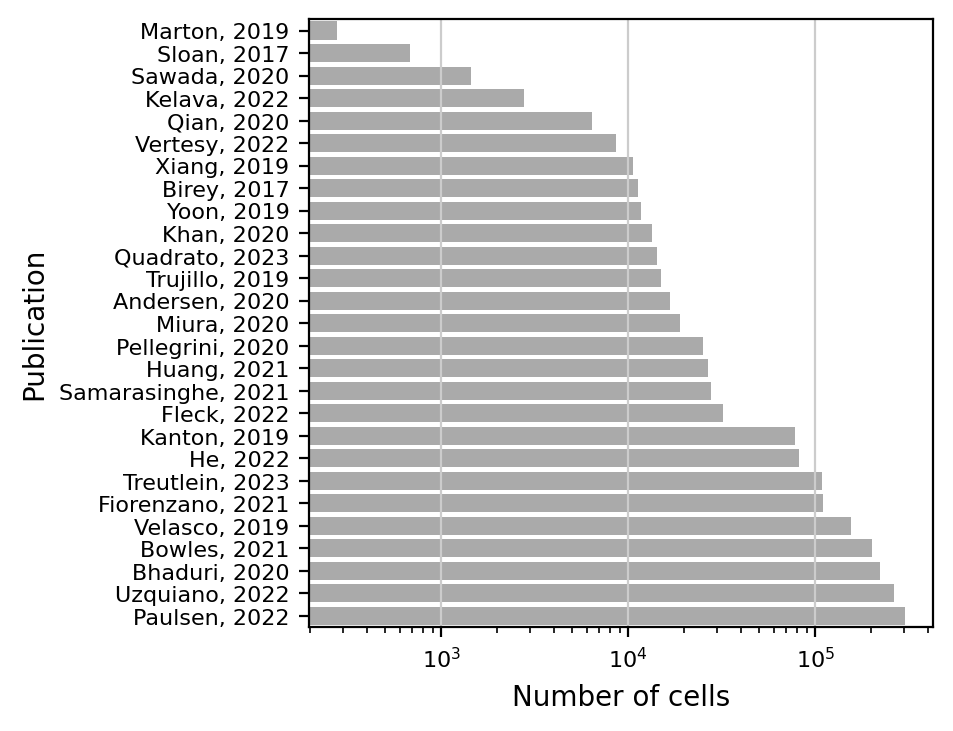

In [336]:
df = adata.obs["publication"].value_counts().to_frame().sort_values("publication").reset_index()
df["index"] = df["index"].cat.reorder_categories(df["index"].tolist())
g = sns.barplot(df, y="index", x="publication", palette=["#aaaaaa"])
g.set_xscale("log")
plt.xlabel('Number of cells', fontsize=10);
plt.ylabel('Publication', fontsize=10);
plt.tick_params(axis='both', which='major', labelsize=8)
plt.savefig("/storage/data/plots/barchart_ncells.pdf", bbox_inches="tight", dpi=300)
plt.show()

# Save cleaned and hvg objects

In [5]:
for k in list(adata.obsp.keys()).copy():
    if "pca" in k:
        print(k)
        del adata.obsp[k]
for k in list(adata.obsm.keys()).copy():
    if "scpoli" not in k:
        print(k)
        del adata.obsm[k]
del adata.layers["counts"]

knn_pca_rss_connectivities
knn_pca_rss_distances
knn_pca_unintegrated_connectivities
knn_pca_unintegrated_distances
X_pca_rss
X_pca_unintegrated
X_rss
X_umap_pca_rss
X_umap_pca_unintegrated


In [8]:
adata.write("/storage/data/organoid_atlas_adatas/230510_08_labelled_organoids_cleaned.h5ad", compression="gzip")

In [7]:
adata = adata[:, adata.var["highly_variable"]].copy()

In [18]:
for k in list(adata.obsp.keys()).copy():
    if "pca" in k:
        del adata.obsp[k]
for k in list(adata_hvg.obsm.keys()).copy():
    if "scpoli" not in k:
        del adata.obsm[k]
del adata.layers["counts"]

In [20]:
adata.write("/storage/data/organoid_atlas_adatas/230510_08_labelled_organoids_cleaned_hvg.h5ad", compression="gzip")

# scPoli sample embeddings

In [ ]:
se = sc.read("/storage/data/organoid_atlas_adatas/230510_data/scpoli_hierarchical123/organoids_scpoli_herarchical123_sample_embedding.h5ad")

In [86]:
sc.pp.pca(se)

computing PCA
    with n_comps=4
    finished (0:00:00)


In [100]:
se.obs = adata.obs.groupby("batch").first().loc[se.obs.index.tolist()]

/home/ubuntu/venv/organoids/lib/python3.10/site-packages/anndata/_core/anndata.py:798: UserWarning: 
AnnData expects .obs.index to contain strings, but got values like:
    ['homosapiens_hindbrain_2020_bdrhapsodywholetranscriptomeanalysis_andersenjimena_001_d10_1016_j_cell_2020_11_017---homosapiens_hindbrain_2020_bdrhapsodywholetranscriptomeanalysis_andersenjimena_001_d10_1016_j_cell_2020_11_0178858-1---homosapiens_hindbrain_2020_bdrhapsodywholetranscriptomeanalysis_andersenjimena_001_d10_1016_j_cell_2020_11_0178858-1', 'homosapiens_hindbrain_2020_bdrhapsodywholetranscriptomeanalysis_andersenjimena_002_d10_1016_j_cell_2020_11_017---homosapiens_hindbrain_2020_bdrhapsodywholetranscriptomeanalysis_andersenjimena_002_d10_1016_j_cell_2020_11_0178858-1---homosapiens_hindbrain_2020_bdrhapsodywholetranscriptomeanalysis_andersenjimena_002_d10_1016_j_cell_2020_11_0178858-1', 'homosapiens_hindbrain_2020_10x3v3_andersenjimena_003_d10_1016_j_cell_2020_11_017---homosapiens_hindbrain_2020_10x3v3_ande

In [ ]:
sc.set_figure_params(dpi_save=300, dpi=100, format="png", frameon=False, fontsize=5, transparent=True)
sc.settings.figdir = "/storage/data/plots/sample_embeddings/"

/home/ubuntu/venv/organoids/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


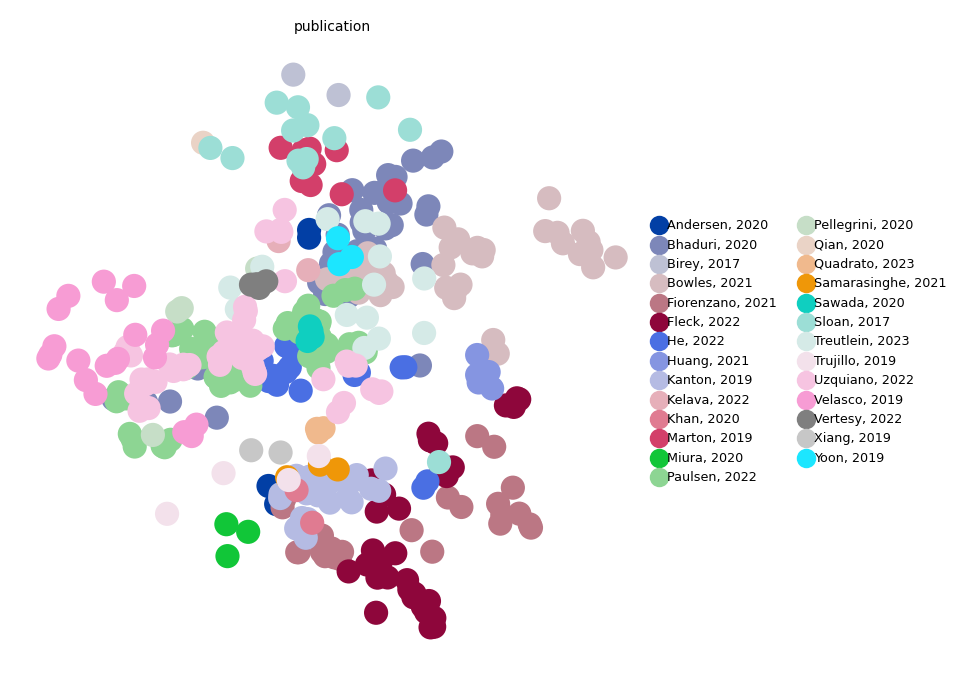

/home/ubuntu/venv/organoids/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


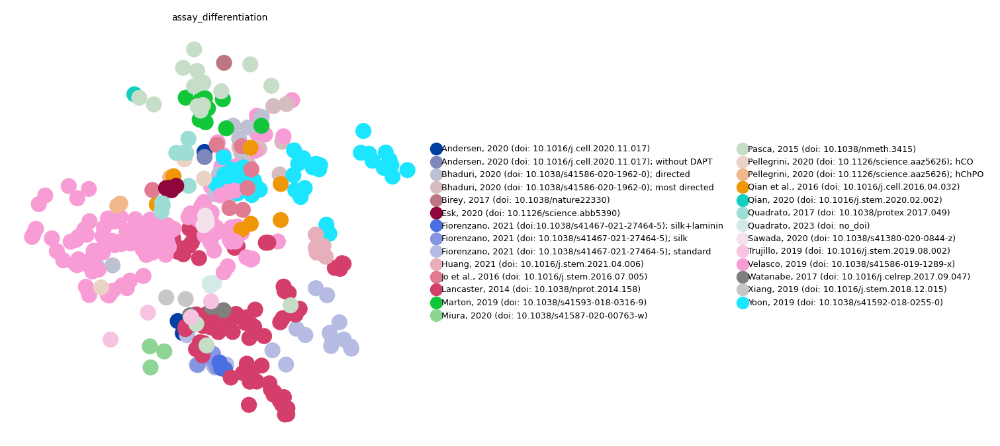

/home/ubuntu/venv/organoids/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


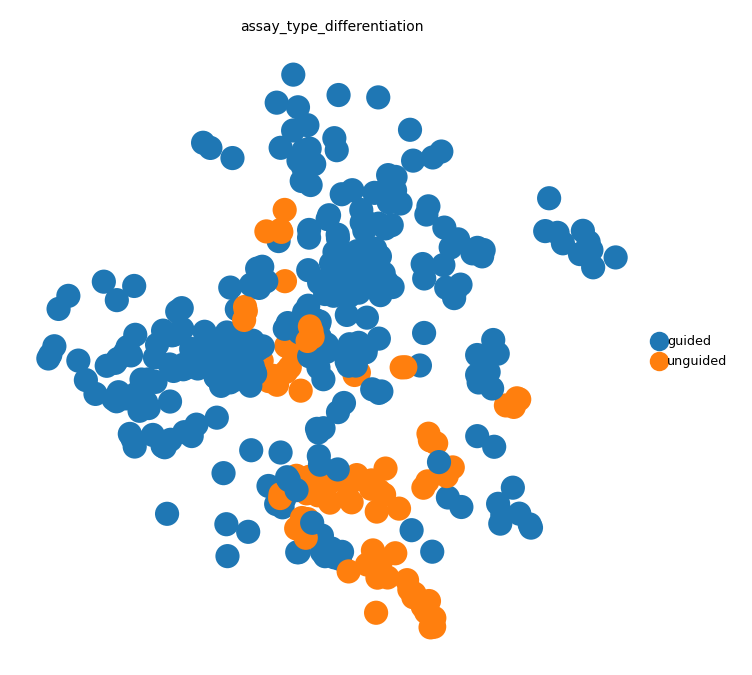

/home/ubuntu/venv/organoids/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


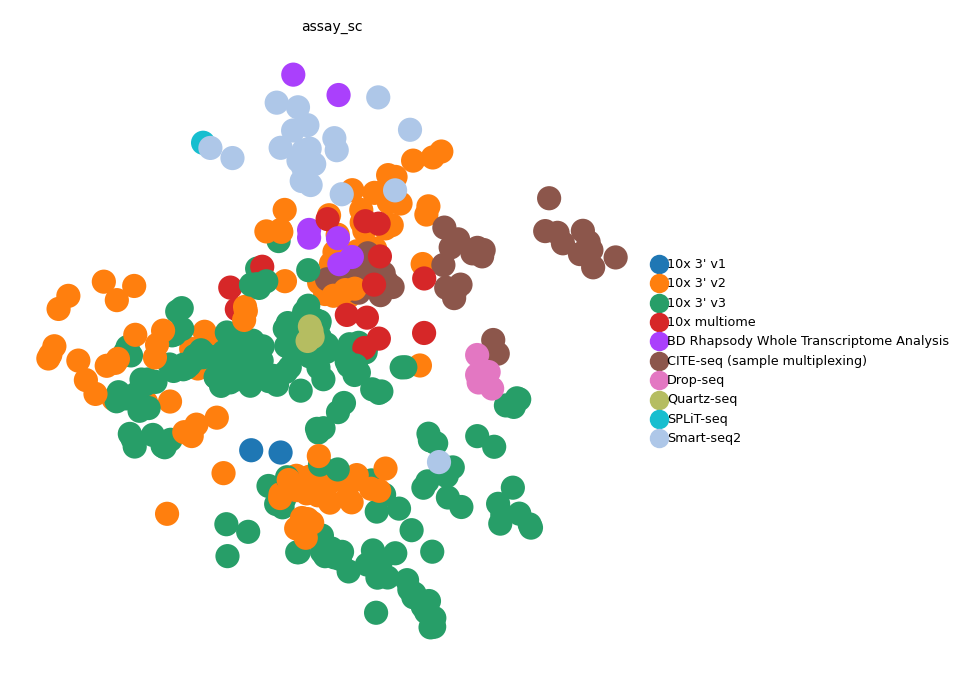

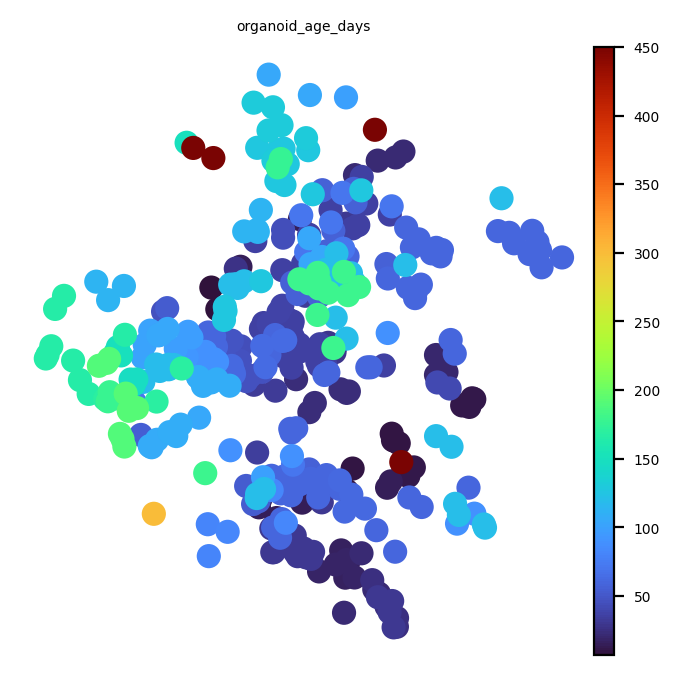

/home/ubuntu/venv/organoids/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


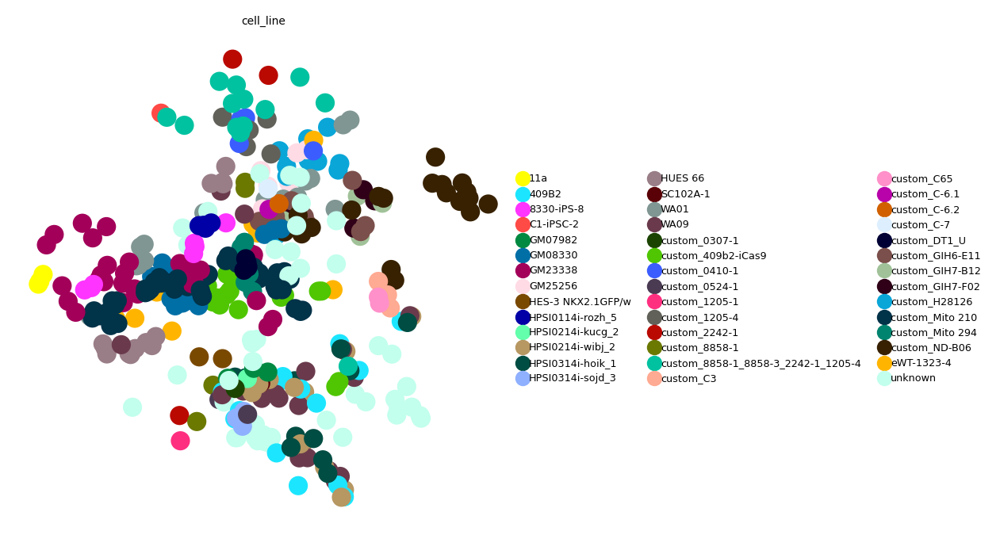

/home/ubuntu/venv/organoids/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


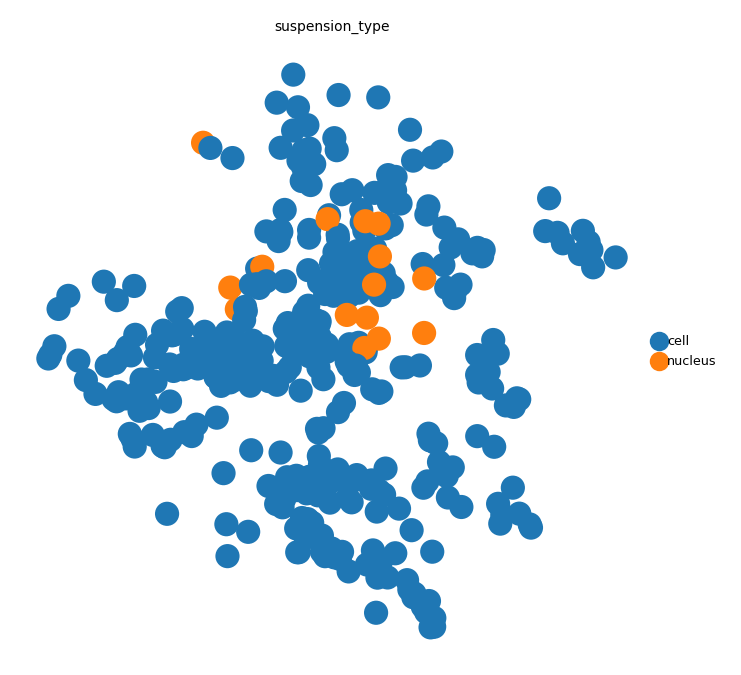

In [116]:
for k in [
    "publication",
    "assay_differentiation",
    "assay_type_differentiation",
    "assay_sc",
    "organoid_age_days",
    "cell_line",
    "suspension_type",
]:
    sc.pl.pca(se, color=k, cmap="turbo", save=f"_{k}.pdf")